In [2]:
import nussl
import scipy.io.wavfile as wav
import numpy as np
import scipy.signal
from scipy.ndimage.interpolation import shift

import IPython

%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt

In [3]:
def delay(data, num_frames):
    return shift(data, num_frames)

def attenuate(data, attenuation):
    return data * (1-attenuation)

def add_reverb(signal, i_r):
    out = scipy.signal.fftconvolve(signal, i_r)
    return out/max(abs(out))
        
def plot_stereo(signal):
    fig = plt.figure()
    ax1 = fig.add_subplot(211)
    ax1.grid(True)
    ax1.axhline(0, color='black', lw=2)
    ax1.plot(signal[0])

    ax2 = fig.add_subplot(212, sharex=ax1)
    ax2.grid(True)
    ax2.axhline(0, color='black', lw=2)
    ax2.plot(signal[1])

    plt.show()

In [5]:
import unittest
from unittest import *

class TestDuetGeneration(unittest.TestCase):
    
    def setUp(self):
        self.src = 'audio/bassviol.wav'
        self.sr, self.sig = wav.read(self.src)
        self.sig = self.sig[0:10*self.sr]
        self.audiosig = nussl.AudioSignal().load_audio_from_file(self.src, signal_length = 10)
    
     
    def test_delay(self):
        self.assertTrue(np.array_equal(self.sig, delay(self.sig, 0)))
        
        d = 20
        new_sig = delay(self.sig, d)
        
        for i in xrange(d, self.sig.size):
            self.assertEqual(new_sig[i], self.sig[i-d])
    
    def test_attenuate(self):
        print attenuate(self.sig, 0)
        self.assertTrue(np.array_equal(self.sig, attenuate(self.sig, 0)))


In [80]:
suite = unittest.TestLoader().loadTestsFromTestCase( TestDuetGeneration )
unittest.TextTestRunner().run( suite )

..

[  -2.   -4.   -1. ...,  276.  283.  291.]



----------------------------------------------------------------------
Ran 2 tests in 10.634s

OK


<unittest.runner.TextTestResult run=2 errors=0 failures=0>

In [5]:
import wave
src = 'audio/bassviol.wav'
IPython.display.Audio(src)

In [6]:
sr, sig = wav.read(src)
IPython.display.Audio(sig[0:10*sr], rate=sr)

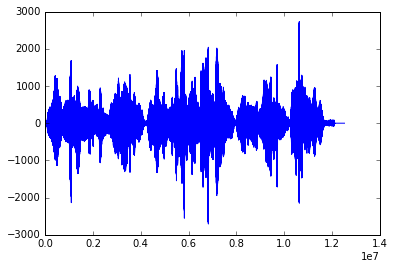

In [7]:
plt.plot(sig)

In [96]:
audio_sig = nussl.AudioSignal()
audio_sig.load_audio_from_file(src, signal_length = 10)
IPython.display.Audio(audio_sig.audio_data, rate=audio_sig.sample_rate)

In [14]:
ir = np.zeros((sr*10,))
ir[0] = 1.0
echo = add_reverb(sig[0:20*sr], ir)
IPython.display.Audio(echo, rate=sr)

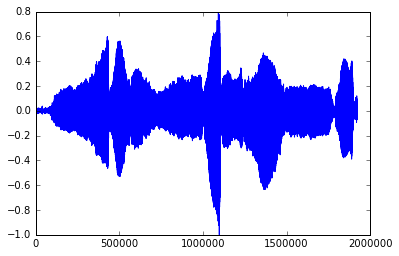

In [15]:
plt.plot(echo)

[[ 2  6]
 [ 3  8]
 [ 6  4]
 ..., 
 [-1 -1]
 [ 1  1]
 [ 0 -1]]


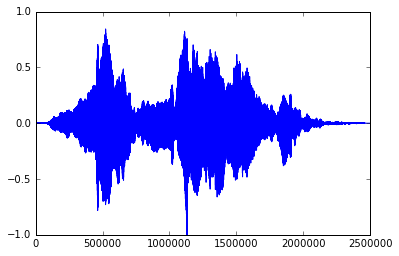

In [18]:
reverb = 'audio/ir/silo16.wav'
sr_ir, ir = wav.read(reverb)
echo2 = add_reverb(sig[0:20*sr], ir[:,0])
plt.plot(echo2)

In [19]:
scipy.io.wavfile.write('audio/mix_reverb.wav', sr, echo)

In [ ]:
src1 = 'audio/bassviol.wav'
sr1, data1 = wav.read(src1)

src2 = 'audio/trebleviol.wav'
sr2, data2 = wav.read(src2)

reverb = 'audio/ir/silo16.wav'
sr_ir, data_ir = wav.read(reverb)
data_ir = data_ir.T

sample1 = data1[0:10*sr1]
sample2 = data2[0:10*sr1]
left =  sample1 + sample2
right = attenuate(sample1, .25) + attenuate(sample2, -.25)

signal = np.vstack((left, right))
plot_stereo(signal)

In [ ]:
signal_norm = signal/max(abs(signal))
plot_stereo(signal_norm)

In [ ]:
scipy.io.wavfile.write('audio/mix_dry.wav', sr1, signal)

In [ ]:
wet_mix = add_reverb(signal, data_ir)
plot_stereo(wet_mix)